<a href="https://colab.research.google.com/github/Mapc1/vcpi-individual-23/blob/main/final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
%pip install tensorflow-addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 591.0/591.0 kB 17.9 MB/s eta 0:00:00


In [2]:
import tensorflow as tf
from tensorflow.keras.layers import (
    Conv2D,
    Conv2DTranspose,
    Reshape,
    Flatten,
    Dense,
    BatchNormalization,
    LeakyReLU,
    Input,
    Dropout,
    Activation,
    MaxPool2D,
    Concatenate
)
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.data.experimental import AUTOTUNE
from keras.utils import plot_model
from tensorflow.keras.callbacks import (
    ModelCheckpoint,
    EarlyStopping,
    ReduceLROnPlateau,
    TensorBoard
)
import tensorflow_addons as tfa

from PIL import Image
import numpy as np
from IPython.display import clear_output
from IPython.display import Image

import matplotlib.pyplot as plt

import glob
import os
import time
import math

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


# Constants

In [4]:
BUFFER_SIZE = 20
BATCH_SIZE = 32

LATENT_DIM = 256

IN_CHANNELS = 1
OUT_CHANNELS = 3
EPOCHS = 50

LATENT_DIM = 256

# Image width and height
WIDTH=128
HEIGHT=128

TRAIN_ONLINE = True

# Auxiliary functions

These are simple auxiliary functions that will help us view the images that are generated by our model

In [5]:
# Constants
SAVE_IMGS_PATH = '/content/generated_images'
EPOCHS_TO_KEEP_IMGS = 10

READ_ONLINE = True
READ_EXTRA_DS_ONLINE = True

In [6]:
# Displays a batch of images
def show_batch(image_batch, cmap='viridis', vmin=0, vmax=1):
    columns = 8
    rows = len(image_batch) / columns + 1
    plt.figure(figsize=(16, 2 * rows))
    for n in range(len(image_batch)):
        ax = plt.subplot(int(rows), columns, n+1)
        plt.imshow((image_batch[n]), vmin=vmin, vmax=vmax, cmap=cmap)
        plt.axis('off')

# Generates the images displays them and saves them to the disk
def generate_and_save_images(model, epoch, test_input, target_imgs):
    predictions = model(test_input, training=False)

    fig, axes = plt.subplots(NUM_EXAMPLES,3)
    fig.set_size_inches(10,50)
    for i in range(NUM_EXAMPLES):
        img_pos1 = axes[i,0]
        img_pos1.set_title(f'Input')
        img_pos1.axis('off')
        img_pos1.imshow(test_input[i], cmap='gray')

        img_pos2 = axes[i,1]
        img_pos2.set_title(f'Target')
        img_pos2.axis('off')
        img_pos2.imshow(target_imgs[i])

        img_pos3 = axes[i,2]
        img_pos3.set_title(f'Prediction')
        img_pos3.axis('off')
        img_pos3.imshow(predictions[i])

    plt.savefig('{folder}/image_at_epoch_{epoch:04d}.png'.format(folder=SAVE_IMGS_PATH, epoch=epoch))
    plt.show()

    if epoch > EPOCHS_TO_KEEP_IMGS: # Keep only last EPOCHS_TO_KEEP_IMGS epochs
        epoch_to_remove = epoch - EPOCHS_TO_KEEP_IMGS
        os.remove('{folder}/image_at_epoch_{epoch:04d}.png'.format(folder=SAVE_IMGS_PATH, epoch=epoch_to_remove))

In [7]:
# Create the folder in which we will save the images
os.makedirs(SAVE_IMGS_PATH, exist_ok=True)

# Dataset

## Landscape image examples

### Input image

When loading the images we don't have to load the grayscale versions of the images from disk. We just have to load the colored image, apply the manipulation and create the grayscale version of the image. This makes it easier to apply the random rotations and crops.  

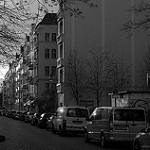

### Target image
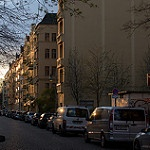

## Cityscapes dataset
The model was having trouble with more urban settings so I've decided to add a dataset to hopefully help with it.

### Original image

Obviously here we don't want the right portion of the image so in preprocessing we remove it and only keep the left image. After applying the data manipulation we create a grayscale version of it and return that as well as the colored version

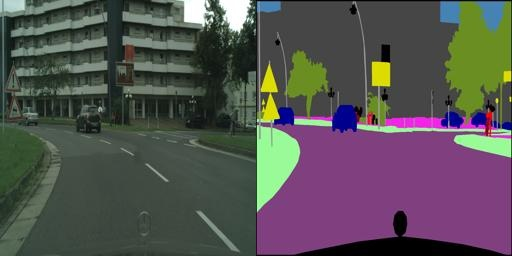

In [10]:
from google.colab import drive
drive.mount('/content/drive')

# This dataset was trained in Google Colab so if you train this somewhere else you might want to change this
if False:
  os.makedirs('/content/datasets', exist_ok=True)
  !unzip '/content/drive/MyDrive/landscape-color.zip' -d '/content/datasets/landscape-image-colorization'
  !unzip '/content/drive/MyDrive/cityscapes-image-pairs.zip' -d '/content/datasets/cityscapes-image-pairs'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [17]:
# Dataset paths
DS_PATH = '/content/datasets/landscape-image-colorization/landscape Images'
EXTRA_DS_PATH = '/content/datasets/cityscapes-image-pairs/cityscapes_data'

Number of images from the extra dataset to be added to our data.

We only select this many to avoid flooding the data with urban images and skewing the results in a way that hurts the performance of the model.

In [18]:
NUM_EXTRA_IMGS = 30

In [19]:
# Apply processing
@tf.function
def process_img(img):
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = tf.image.resize(img, (150,150))

    rotation = tf.random.uniform(shape=(), minval=0, maxval=1) - 0.5
    img = tfa.image.rotate(img,rotation)
    img = tf.image.random_crop(img, size=(HEIGHT,WIDTH,3))

    gray_img = tf.image.rgb_to_grayscale(img)

    return gray_img, img


# Load main dataset image
@tf.function
def read_img(img_path):
    # We don't need to load the grayscale images as we can get them from tf.image.rgb_to_grayscale
    # This makes it easier to apply all the transformations to both images in the exact same manner
    raw_img = tf.io.read_file(img_path)
    img = tf.io.decode_jpeg(raw_img, channels=3)

    return process_img(img)


# Load cityscapes images
@tf.function
def preprocess_extra_img(img_path):
    raw_img = tf.io.read_file(img_path)
    img = tf.io.decode_jpeg(raw_img, channels=3)

    # We only need the first half
    width = tf.shape(img)[1] // 2
    img = img[:, :width, :]

    return process_img(img)

In [20]:
# Number of examples to test the results
NUM_EXAMPLES=16

In [55]:
if READ_ONLINE:
    files = tf.data.Dataset.list_files(f'{DS_PATH}/color/*.jpg')
    dataset = files.map(read_img, num_parallel_calls=AUTOTUNE)

    # Read the urban dataset
    if READ_EXTRA_DS_ONLINE:
        extra_files = tf.data.Dataset.list_files(f'{EXTRA_DS_PATH}/train/*.jpg')
        extra_files = extra_files.concatenate(tf.data.Dataset.list_files(f'{EXTRA_DS_PATH}/val/*.jpg'))
        extra_files = extra_files.shuffle(BUFFER_SIZE)
        extra_files = extra_files.take(NUM_EXTRA_IMGS)

        extra_ds = extra_files.map(preprocess_extra_img, num_parallel_calls=AUTOTUNE)
        dataset = dataset.concatenate(extra_ds)

    # Split 20% into validation set
    val_size = dataset.cardinality().numpy() * 0.2
    val_ds = dataset.take(val_size)
    dataset = dataset.skip(val_size)

    dataset = dataset.shuffle(BUFFER_SIZE)
    dataset = dataset.batch(BATCH_SIZE)

    # We will use one batch to test the output of our model
    test_batch = next(iter(dataset))[:][:NUM_EXAMPLES]

    train_ds = dataset.skip(1)

    train_ds = train_ds.cache()
    train_ds = train_ds.prefetch(buffer_size=BUFFER_SIZE)

    val_ds = val_ds.cache()
    val_ds = val_ds.batch(BATCH_SIZE)

# View dataset images

Input Batch shape: (30, 128, 128, 1)
Output Batch shape: (30, 128, 128, 3)
Number of batches: 1


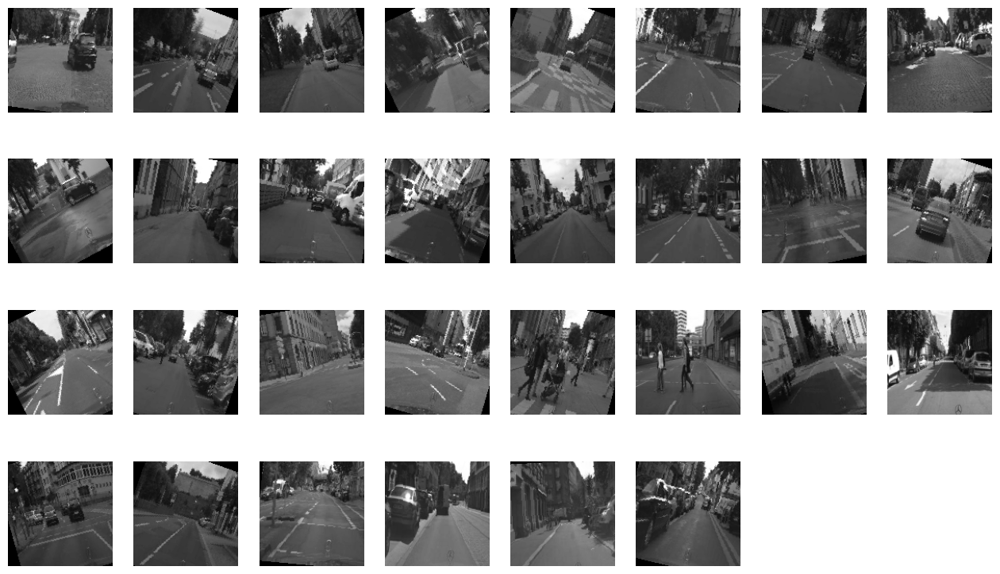

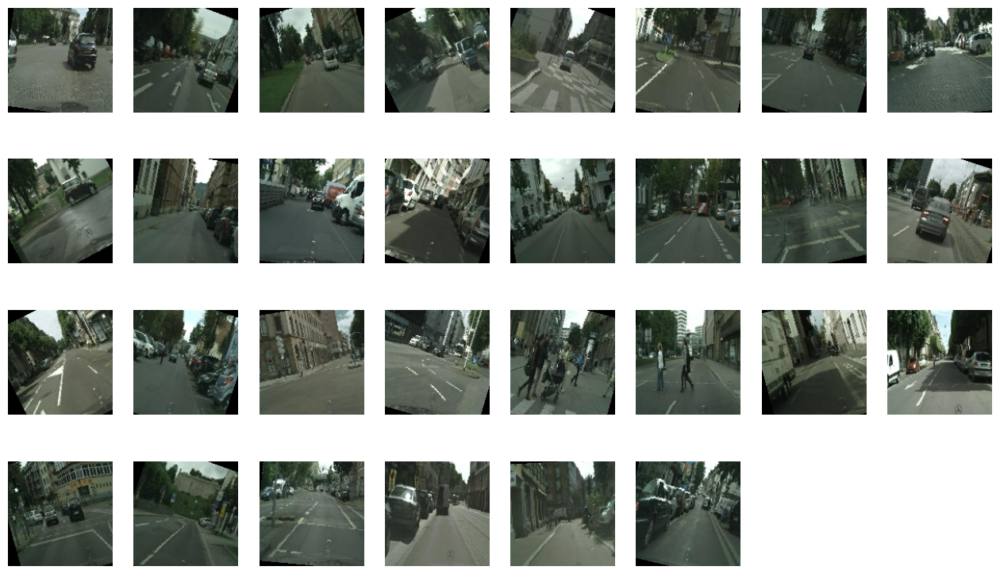

In [56]:
# View extra dataset images
if READ_EXTRA_DS_ONLINE:
    if False:
        # The extra_ds has not been batched so we do it here.
        # This is only done to be able to use the show_batch function
        extra_ds = extra_ds.batch(BATCH_SIZE)
    image_batch = next(iter(extra_ds))
    num_batches = extra_ds.cardinality().numpy()

    print(f'Input Batch shape: {image_batch[0].numpy().shape}')
    print(f'Output Batch shape: {image_batch[1].numpy().shape}')
    print(f'Number of batches: {num_batches}')
    show_batch(image_batch[0], cmap='gray')
    show_batch(image_batch[1])

Input Batch shape: (32, 128, 128, 1)
Output Batch shape: (32, 128, 128, 3)
Number of batches: 178


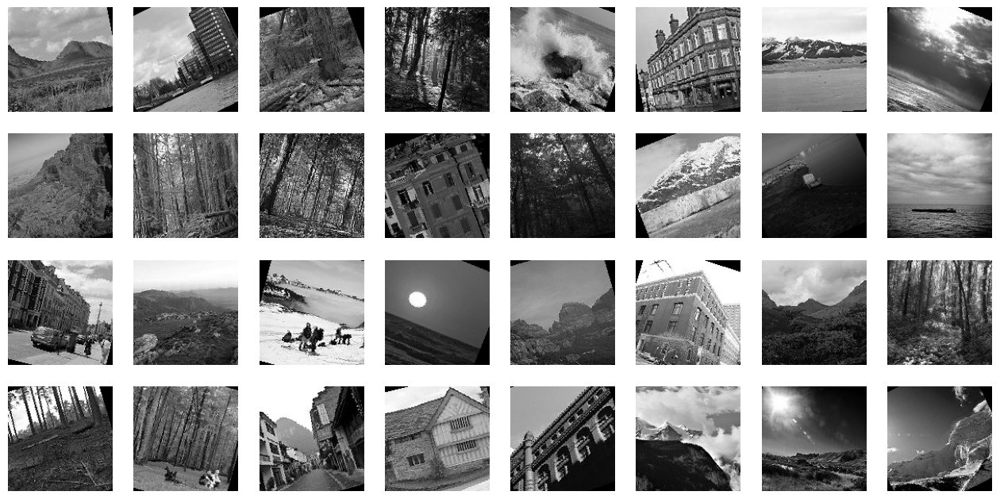

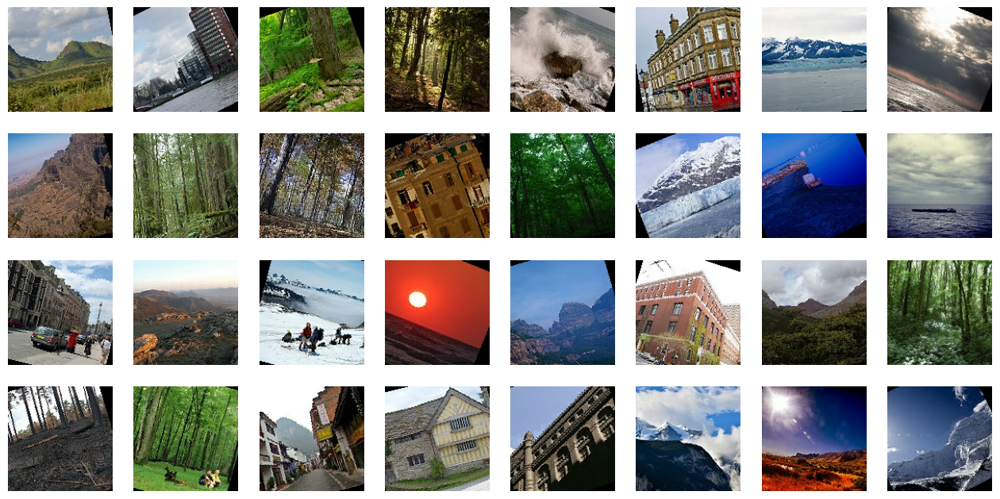

In [57]:
image_batch = next(iter(train_ds))
num_batches = train_ds.cardinality().numpy()

print(f'Input Batch shape: {image_batch[0].numpy().shape}')
print(f'Output Batch shape: {image_batch[1].numpy().shape}')
print(f'Number of batches: {num_batches}')
show_batch(image_batch[0], cmap='gray')
show_batch(image_batch[1])

# UNet
This is the original model we will use. Later on we will try a Pix2Pix GAN model to compare which one works best.

Originaly I had tried with a simple autoencoder, however it was producing very weak results. (You could se some larger shapes like the outline of a building or a mountain, but it was just generating smudges)

Adding the connections between encoder and decoder severely improved results as it started producing actual images.

In [58]:
def make_encoder():
    conv_blocks = []

    inputs = Input(shape=(HEIGHT,WIDTH,IN_CHANNELS))

    encoder = Conv2D(32, (3,3), strides=2, padding='same')(inputs)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    encoder = BatchNormalization()(encoder)
    conv_blocks.append(encoder)

    encoder = Conv2D(64, (3,3), strides=2, padding='same')(encoder)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    encoder = BatchNormalization()(encoder)
    conv_blocks.append(encoder)

    encoder = Conv2D(128, (3,3), strides=2, padding='same')(encoder)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    encoder = BatchNormalization()(encoder)
    conv_blocks.append(encoder)

    shape = encoder.shape

    encoder = Flatten()(encoder)
    encoder = Dense(LATENT_DIM)(encoder)
    encoder = Activation('sigmoid')(encoder)

    return encoder,inputs,shape,conv_blocks


def make_decoder(encoder, inputs, shape, conv_blocks):
    decoder = Dense(shape[1]*shape[2]*shape[3])(encoder)
    decoder = Reshape((shape[1], shape[2], shape[3]))(decoder)

    decoder = Concatenate()([decoder,conv_blocks[2]])
    decoder = Conv2DTranspose(128, (3,3), strides=2, padding='same')(decoder)
    decoder = LeakyReLU(alpha=0.2)(decoder)
    decoder = BatchNormalization()(decoder)

    decoder = Concatenate()([decoder,conv_blocks[1]])
    decoder = Conv2DTranspose(64, (3,3), strides=2, padding='same')(decoder)
    decoder = LeakyReLU(alpha=0.2)(decoder)
    decoder = BatchNormalization()(decoder)

    decoder = Concatenate()([decoder,conv_blocks[0]])
    decoder = Conv2DTranspose(32, (3,3), strides=2, padding='same')(decoder)
    decoder = LeakyReLU(alpha=0.2)(decoder)
    decoder = BatchNormalization()(decoder)

    decoder = Conv2DTranspose(OUT_CHANNELS, (3,3), padding='same')(decoder)
    decoder = Activation('sigmoid')(decoder)

    decoder = Model(inputs, decoder, name='decoder')

    return decoder

In [59]:
encoder, inputs, shape, conv_blocks = make_encoder()

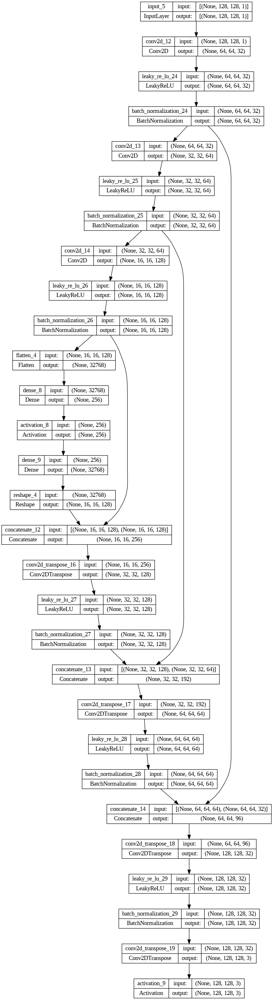

In [60]:
autoencoder = make_decoder(encoder,inputs, shape, conv_blocks)
plot_model(autoencoder, show_shapes=True)

In [61]:
opt = Adam(learning_rate=1e-3)

# We will begin with Mean Square Error to put focus on the larger errors
autoencoder.compile(loss='mse', optimizer=opt)

In [62]:
if TRAIN_ONLINE:
    autoencoder.fit(train_ds, validation_data=val_ds, epochs=EPOCHS, batch_size=BATCH_SIZE)

Epoch 1/50
178/178 [==============================] - 31s 127ms/step - loss: 0.0120 - val_loss: 0.0599
Epoch 2/50
178/178 [==============================] - 11s 59ms/step - loss: 0.0067 - val_loss: 0.0369
Epoch 3/50
178/178 [==============================] - 11s 60ms/step - loss: 0.0063 - val_loss: 0.0147
Epoch 4/50
178/178 [==============================] - 11s 60ms/step - loss: 0.0061 - val_loss: 0.0074
Epoch 5/50
178/178 [==============================] - 11s 60ms/step - loss: 0.0059 - val_loss: 0.0063
Epoch 6/50
178/178 [==============================] - 11s 60ms/step - loss: 0.0057 - val_loss: 0.0067
Epoch 7/50
178/178 [==============================] - 11s 62ms/step - loss: 0.0056 - val_loss: 0.0080
Epoch 8/50
178/178 [==============================] - 11s 63ms/step - loss: 0.0053 - val_loss: 0.0063
Epoch 9/50
178/178 [==============================] - 11s 63ms/step - loss: 0.0051 - val_loss: 0.0066
Epoch 10/50
178/178 [==============================] - 11s 62ms/step - loss: 0.00

The dataset seems to have trouble coloring urban areas.

Also some images, like the last of this test, are not really getting painted at all...

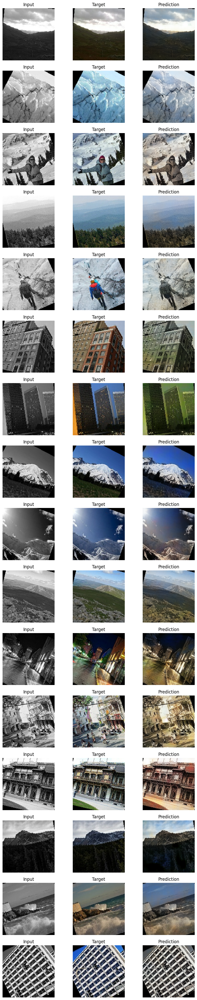

In [63]:
generate_and_save_images(autoencoder, -1, test_batch[0], test_batch[1])

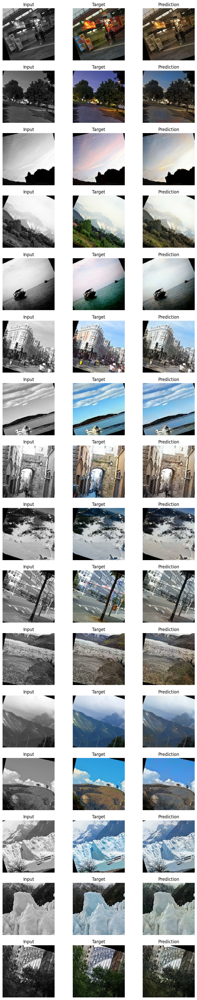

In [65]:
train_test = next(iter(train_ds))

generate_and_save_images(autoencoder, -1, train_test[0], train_test[1])

## Let's try some different losses:

Mean Absolute Error

In [70]:
opt = Adam(learning_rate=1e-3)
# Reset weights
autoencoder = make_decoder(encoder,inputs, shape, conv_blocks)

autoencoder.compile(loss='mae', optimizer=opt)

In [71]:
if TRAIN_ONLINE:
    autoencoder.fit(train_ds, validation_data=val_ds, epochs=50, batch_size=BATCH_SIZE)

Epoch 1/50
178/178 [==============================] - 16s 62ms/step - loss: 0.0606 - val_loss: 0.0757
Epoch 2/50
178/178 [==============================] - 11s 60ms/step - loss: 0.0412 - val_loss: 0.0631
Epoch 3/50
178/178 [==============================] - 11s 63ms/step - loss: 0.0371 - val_loss: 0.0605
Epoch 4/50
178/178 [==============================] - 11s 61ms/step - loss: 0.0349 - val_loss: 0.0588
Epoch 5/50
178/178 [==============================] - 11s 61ms/step - loss: 0.0324 - val_loss: 0.0558
Epoch 6/50
178/178 [==============================] - 11s 61ms/step - loss: 0.0306 - val_loss: 0.0584
Epoch 7/50
178/178 [==============================] - 11s 61ms/step - loss: 0.0297 - val_loss: 0.0599
Epoch 8/50
178/178 [==============================] - 11s 63ms/step - loss: 0.0289 - val_loss: 0.0569
Epoch 9/50
178/178 [==============================] - 11s 62ms/step - loss: 0.0295 - val_loss: 0.0574
Epoch 10/50
178/178 [==============================] - 11s 62ms/step - loss: 0.029

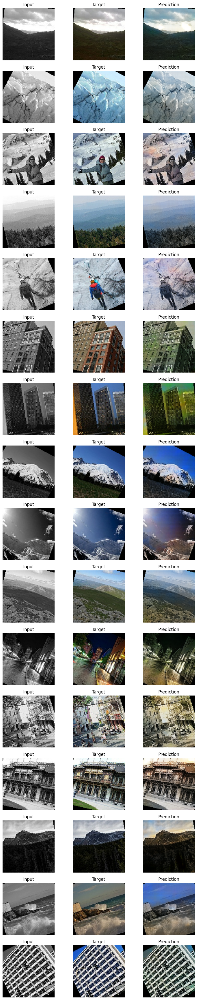

In [72]:
generate_and_save_images(autoencoder, -1, test_batch[0], test_batch[1])

Hinge loss

In [78]:
opt = Adam(learning_rate=1e-3)
# Reset weights
autoencoder = make_decoder(encoder,inputs, shape, conv_blocks)

autoencoder.compile(loss=tf.keras.losses.Hinge(), optimizer='sgd')

In [ ]:
if TRAIN_ONLINE:
   autoencoder.fit(train_ds, validation_data=val_ds, epochs=50, batch_size=BATCH_SIZE)

Epoch 1/50
 74/178 [===========>..................] - ETA: 6s - loss: 0.7653

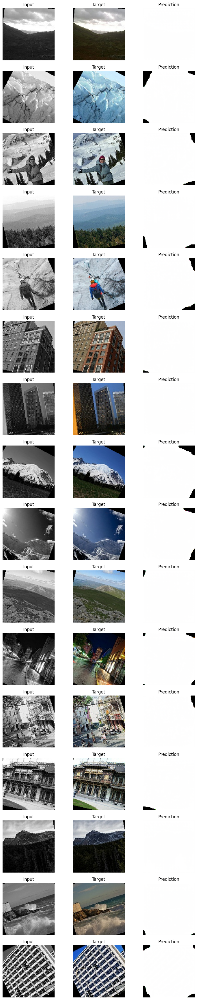

In [75]:
generate_and_save_images(autoencoder, -1, test_batch[0], test_batch[1])

# Pix2Pix

A Pix2Pix GAN is a patch GAN that focuses in image to image datasets.

The generator is usually a UNet and the descriminator takes 2 inputs. The input image and the generated/target image.

The paper for the model can be found [here](https://arxiv.org/abs/1611.07004).

A tensorflow tutorial on the matter can be found [here](https://www.tensorflow.org/tutorials/generative/pix2pix).

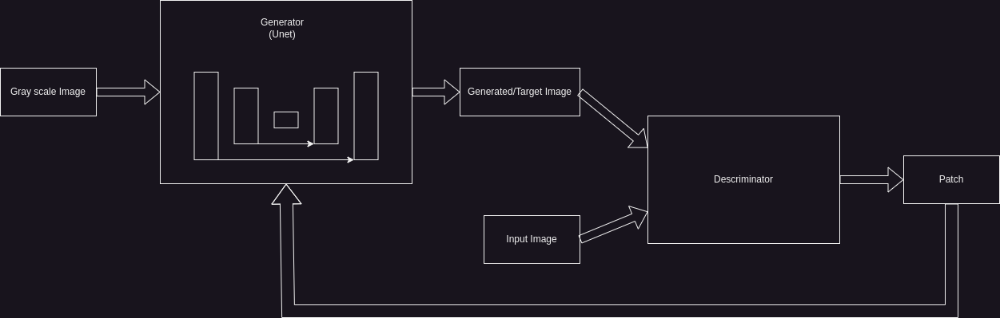

## Generator

For the generator we will use a more powerful version of the UNet used previously.

Initially I used the previous model without any modifications but the GAN was suffering from mode collapse as the generator was not able to generate good enough results to fool the descriminator.

In [57]:
def make_generator():
    inputs = Input(shape=(HEIGHT,WIDTH,IN_CHANNELS))

    encoder = Conv2D(64, (5,5), strides=2, padding='same')(inputs)
    encoder = BatchNormalization()(encoder)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    conv1 = Dropout(0.2)(encoder)

    encoder = Conv2D(128, (5,5), strides=2, padding='same')(conv1)
    encoder = BatchNormalization()(encoder)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    conv2 = Dropout(0.2)(encoder)

    encoder = Conv2D(256, (5,5), strides=2, padding='same')(conv2)
    encoder = BatchNormalization()(encoder)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    conv3 = Dropout(0.2)(encoder)

    encoder = Conv2D(512, (5,5), strides=2, padding='same')(conv3)
    encoder = BatchNormalization()(encoder)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    conv4 = Dropout(0.2)(encoder)

    encoder = Conv2D(512, (5,5), strides=2, padding='same')(conv4)
    encoder = BatchNormalization()(encoder)
    encoder = LeakyReLU(alpha=0.2)(encoder)
    encoder = Dropout(0.2)(encoder)

    decoder = Conv2DTranspose(512, (5,5), strides=2, padding='same')(encoder)
    decoder = BatchNormalization()(decoder)
    decoder = LeakyReLU(alpha=0.2)(decoder)
    decoder = Dropout(0.2)(decoder)

    decoder = Concatenate()([decoder,conv4])
    decoder = Conv2DTranspose(256, (5,5), strides=2, padding='same')(decoder)
    decoder = BatchNormalization()(decoder)
    decoder = LeakyReLU(alpha=0.2)(decoder)
    decoder = Dropout(0.2)(decoder)

    decoder = Concatenate()([decoder,conv3])
    decoder = Conv2DTranspose(128, (5,5), strides=2, padding='same')(decoder)
    decoder = BatchNormalization()(decoder)
    decoder = LeakyReLU(alpha=0.2)(decoder)
    decoder = Dropout(0.2)(decoder)

    decoder = Concatenate()([decoder,conv2])
    decoder = Conv2DTranspose(64, (5,5), strides=2, padding='same')(decoder)
    decoder = BatchNormalization()(decoder)
    decoder = LeakyReLU(alpha=0.2)(decoder)
    decoder = Dropout(0.2)(decoder)

    decoder = Concatenate()([decoder,conv1])
    decoder = Conv2DTranspose(OUT_CHANNELS, (5,5), strides=2, padding='same')(decoder)

    decoder = Activation('sigmoid')(decoder)

    return Model(inputs, decoder, name='generator')

In [ ]:
generator = make_generator()
plot_model(generator, show_shapes=True)

## Descriminator

The discriminator differs from a "normal" GAN in the fact that it takes two images. (Input, Generated/Target)

It's purpose is to tell if the second image is the target of the first.

This discriminator outputs a patch of (16,16).

In [67]:
def make_discriminator():
    # Grayscale image
    input_image = Input(shape=(128,128,1), name='input_image')
    # Colored image (can be the target image or our generated image)
    target_image = Input(shape=(128,128,3), name='target_image')

    inputs = tf.keras.layers.concatenate([input_image, target_image])

    discriminator = Conv2D(16, (5,5), strides=2, padding='same')(inputs)
    discriminator = LeakyReLU(alpha=0.2)(discriminator)
    discriminator = Dropout(0.2)(discriminator)

    discriminator = Conv2D(32, (5,5), strides=2, padding='same')(discriminator)
    discriminator = BatchNormalization()(discriminator)
    discriminator = LeakyReLU(alpha=0.2)(discriminator)
    discriminator = Dropout(0.2)(discriminator)

    discriminator = Conv2D(64, (5,5), strides=2, padding='same')(discriminator)
    discriminator = BatchNormalization()(discriminator)
    discriminator = LeakyReLU(alpha=0.2)(discriminator)
    discriminator = Dropout(0.2)(discriminator)

    discriminator = Conv2D(128, (5,5), strides=1, padding='same')(discriminator)
    discriminator = BatchNormalization()(discriminator)
    discriminator = LeakyReLU(alpha=0.2)(discriminator)

    discriminator = Conv2D(1, (5,5), strides=1, padding='same')(discriminator)

    return Model(inputs=(input_image,target_image), outputs=discriminator)

In [ ]:
discriminator = make_discriminator()
plot_model(discriminator, show_shapes=True)

## Losses

We will begin with a simple binary crossentropy for the discriminator loss

In [68]:
LOSS = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Generator loss

The generator's loss is divided into two components. The discriminator loss and the level 1 loss.

The level 1 loss is the difference between the generated image and the target image.

The gan loss is how well the generator was able to fool the discriminator.

The tensorflow tutorial recommends using the Mean Absolute Error for the level 1 loss with a weight(LAMBDA) of 100.

In [69]:
LAMBDA = 100

def generator_loss(disc_gen_output, gen_output, target):
    gan_loss = LOSS(tf.ones_like(disc_gen_output), disc_gen_output)

    # MAE
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    return (LAMBDA * l1_loss) + gan_loss

### Discriminator loss

The discriminator loss is like any other patch GAN.

As stated before the output is a patch of (16,16).

In [ ]:
def discriminator_loss(disc_real_output, disc_gen_output):
    real_loss = LOSS(tf.ones_like(disc_real_output), disc_real_output)
    gen_loss = LOSS(tf.zeros_like(disc_gen_output), disc_gen_output)

    return real_loss + gen_loss

## Optimizers

In [ ]:
gen_opt = Adam(learning_rate=5e-4, beta_1=0.3)
disc_opt = Adam(learning_rate=5e-4, beta_1=0.3)

## Train step

This is the tipical train step for a GAN

In [ ]:
@tf.function
def train_step(input_img, target_img):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_img, training=True)

        disc_real_output = discriminator((input_img, target_img), training=True)
        disc_gen_output = discriminator((input_img, gen_output), training=True)

        gen_loss = generator_loss(disc_gen_output, gen_output, target_img)
        disc_loss = discriminator_loss(disc_real_output, disc_gen_output)

    gen_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    disc_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    gen_opt.apply_gradients(zip(gen_gradients,generator.trainable_variables))
    disc_opt.apply_gradients(zip(disc_gradients,discriminator.trainable_variables))

    return gen_loss, disc_loss

## Callbacks

In [70]:
BEST_GEN_LOSS = math.inf
BEST_DISC_LOSS = math.inf

EPOCHS_WITHOUT_GEN_LOSS_IMPROVING = 0
EPOCHS_WITHOUT_DISC_LOSS_IMPROVING = 0

PATIENCE = 5

In [ ]:
# Reduces the learning rate of the generator and/or discriminator if their loss
# hasn't improved after PATIENCE epochs
def reduce_lr_cb(avg_gen_loss, avg_disc_loss):
    global best_gen_loss, best_disc_loss, epochs_without_gen_loss_improv, epochs_without_disc_loss_improv

    if avg_gen_loss < best_gen_loss:
        best_gen_loss = avg_gen_loss
    else:
        epochs_without_gen_loss_improv += 1
        if epochs_without_gen_loss_improv >= PATIENCE:
            tf.keras.backend.set_value(gen_opt.learning_rate, gen_opt.learning_rate/2)
            print(f'Learning rate reduced to {gen_opt.learning_rate}')
            epochs_without_gen_loss_improv = 0

    if avg_disc_loss < best_disc_loss:
        best_disc_loss = avg_disc_loss
    else:
        epochs_without_disc_loss_improv += 1
        if epochs_without_disc_loss_improv >= PATIENCE:
            tf.keras.backend.set_value(disc_opt.learning_rate, disc_opt.learning_rate/2)
            print(f'Learning rate reduced to {disc_opt.learning_rate}')
            epochs_without_disc_loss_improv = 0

In [ ]:
CALLBACKS = [reduce_lr_cb]

##

In [ ]:
NUM_BATCHES = train_ds.cardinality().numpy()

def train()
    for epoch in range(EPOCHS):
        epoch_disc_loss = 0
        epoch_gen_loss = 0

        for batch in train_ds:
            gen_loss, disc_loss = train_step(batch[0], batch[1])
            avg_gen_loss += gen_loss
            avg_disc_loss += disc_loss

        epoch_gen_loss /= NUM_BATCHES
        epoch_disc_loss /= NUM_BATCHES

        clear_output()
        print(f'Epoch: {epoch}')
        print(f'EPOCH GEN LOSS: {avg_gen_loss}')
        print(f'EPOCH DISC LOSS: {avg_disc_loss}')

        if epoch % 5 == 0:
            generate_and_save_images(generator, epoch, test_batch[0], test_batch[1])

        # Run all callbacks
        for callback in CALLBACKS:
            callback(avg_gen_loss,avg_disc_loss)